In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
from wordcloud import WordCloud
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.naive_bayes import MultinomialNB
from sklearn.metrics import classification_report, confusion_matrix

c:\Users\User\anaconda3\Lib\site-packages\pandas\core\arrays\masked.py:60: UserWarning: Pandas requires version '1.3.6' or newer of 'bottleneck' (version '1.3.5' currently installed).
  from pandas.core import (


# Load the dataset

In [2]:
df = pd.read_csv('messages.csv')
df.head()

,Unnamed: 0,text,label
0,0,i just feel really helpless and heavy hearted,4
1,1,ive enjoyed being able to slouch about relax a...,0
2,2,i gave up my internship with the dmrg and am f...,4
3,3,i dont know i feel so lost,0
4,4,i am a kindergarten teacher and i am thoroughl...,4


In [3]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 416809 entries, 0 to 416808
Data columns (total 3 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   Unnamed: 0  416809 non-null  int64 
 1   text        416809 non-null  object
 2   label       416809 non-null  int64 
dtypes: int64(2), object(1)
memory usage: 9.5+ MB


In [4]:
df.describe()

,Unnamed: 0,label
count,416809.000000,416809.000000
mean,208404.000000,1.554271
std,120322.538513,1.490453
min,0.000000,0.000000
25%,104202.000000,0.000000
50%,208404.000000,1.000000
75%,312606.000000,3.000000
max,416808.000000,5.000000


In [5]:
# Mapping numerical labels to emotion names
emotion_mapping = {0: 'Sadness', 1: 'Joy', 2: 'Love', 3: 'Anger', 4: 'Fear', 5: 'Surprise'}
df['emotion_name'] = df['label'].map(emotion_mapping)

# Map the emotions to the values

In [6]:
emotion_distribution = df['emotion_name'].value_counts().reset_index()
emotion_distribution.columns = ['Emotion', 'Count']

fig = px.pie(emotion_distribution, names='Emotion', values='Count', title='Emotion Distribution')
fig.update_traces(textposition='inside', textinfo='percent+label')
fig.show()

In [7]:
# Visualize the distribution of emotions using an interactive histogram
fig = px.histogram(df, x='emotion_name', title='Emotion Distribution',
                   labels={'emotion_name': 'Emotion Label', 'count': 'Number of Tweets'})
fig.update_layout(bargap=0.1)
fig.show()

In [8]:
# Explore correlations between text length and emotions
fig = px.scatter(df, x=df['text'].apply(len), y='emotion_name', title='Correlation between Text Length and Emotions',
                 labels={'x': 'Text Length', 'y': 'Emotion Label'})
fig.update_traces(marker=dict(size=8, color='blue'), selector=dict(mode='markers'))
fig.show()

# Display the word clouds for each emotion

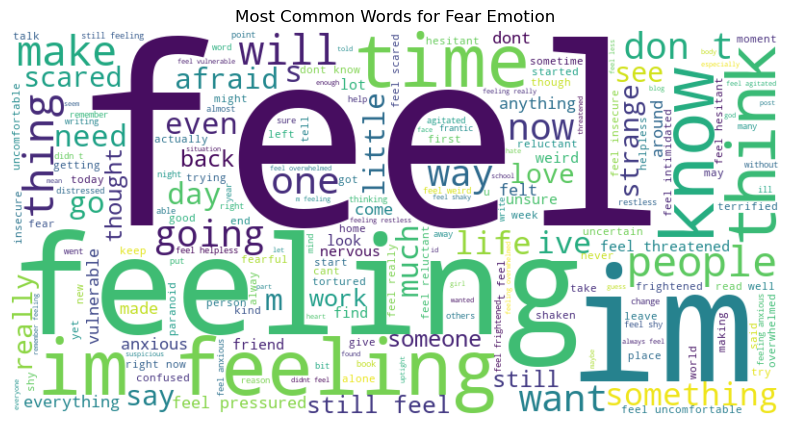

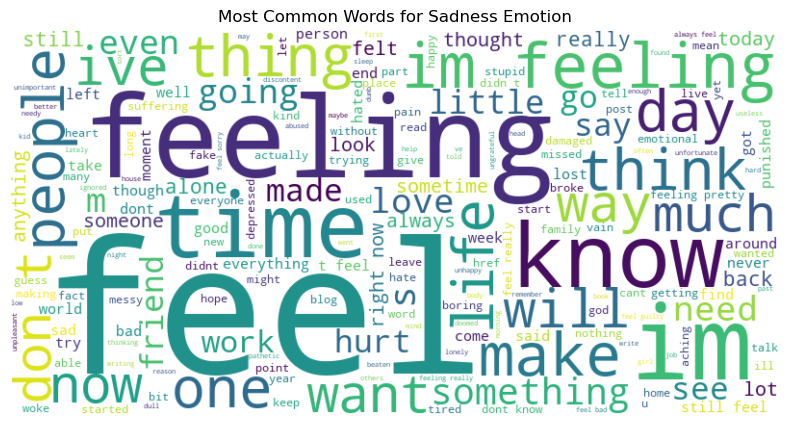

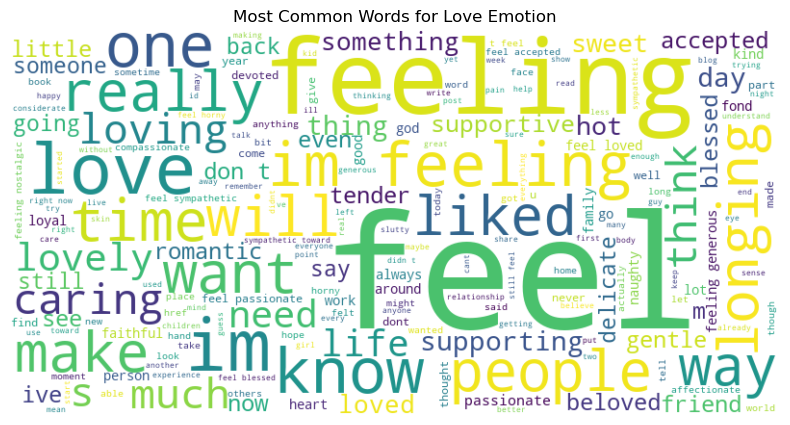

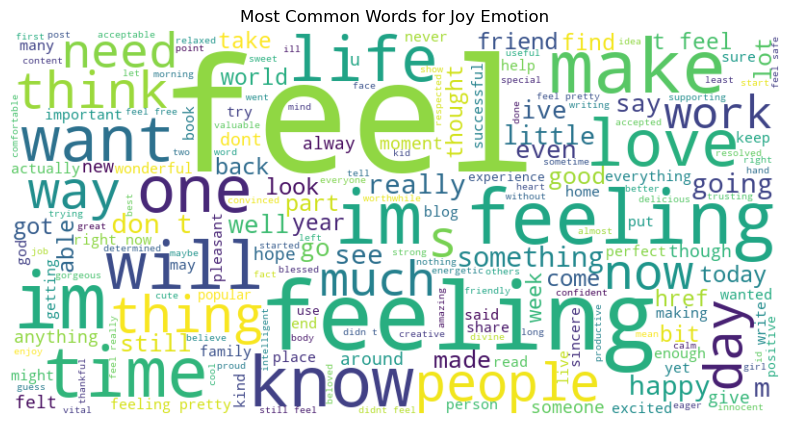

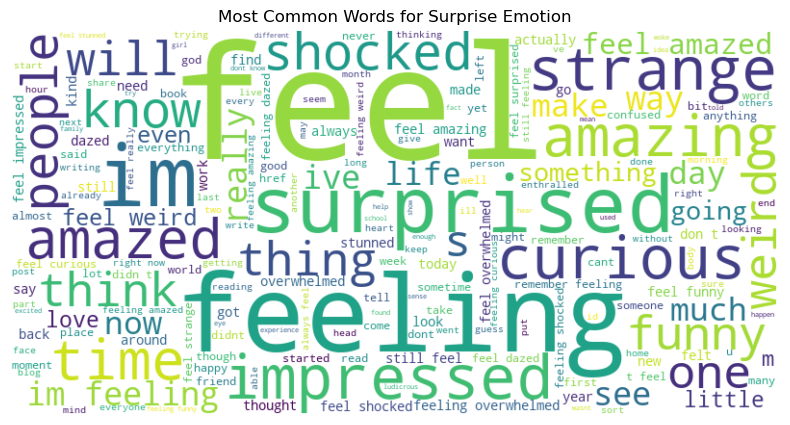

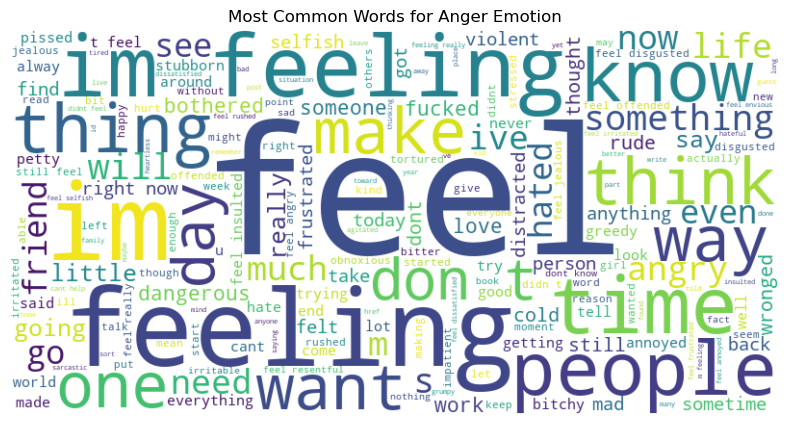

In [9]:
emotions = df['emotion_name'].unique()
for emotion in emotions:
    words = ' '.join(df[df['emotion_name'] == emotion]['text'])
    wordcloud = WordCloud(width=800, height=400, background_color='white').generate(words)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.title(f'Most Common Words for {emotion} Emotion')
    plt.show()

# Preprocess the text messages

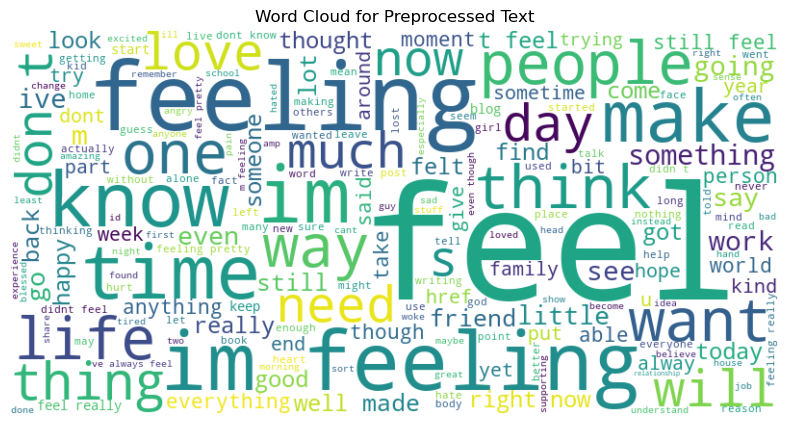

In [10]:
# Function for text preprocessing
def preprocess_text(text):
    # Convert to lowercase
    text = text.lower()
    # Remove special characters, links, and numbers
    text = ' '.join([word for word in text.split() if word.isalpha()])
    # Add more preprocessing steps if necessary

    return text

# Apply text preprocessing to the entire dataset
df['preprocessed_text'] = df['text'].apply(preprocess_text)

# Visualize word cloud for preprocessed text
preprocessed_words = ' '.join(df['preprocessed_text'])
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(preprocessed_words)

plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Word Cloud for Preprocessed Text')
plt.show()

# Train and test accuracy of the model

In [11]:
# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df['preprocessed_text'], df['label'], test_size=0.2, random_state=42)

# Initialize TF-IDF vectorizer
tfidf_vectorizer = TfidfVectorizer(max_features=5000)

# Fit and transform the training set
X_train_tfidf = tfidf_vectorizer.fit_transform(X_train)

# Transform the test set
X_test_tfidf = tfidf_vectorizer.transform(X_test)

# Initialize and train the Naive Bayes classifier
naive_bayes_classifier = MultinomialNB()
naive_bayes_classifier.fit(X_train_tfidf, y_train)

# Evaluate the classifier
accuracy = naive_bayes_classifier.score(X_test_tfidf, y_test)
print("Accuracy:", accuracy)


Accuracy: 0.831625920683285


# Create the model to be used by the Flask app

In [13]:
import joblib

# Save the trained model and TF-IDF vectorizer
joblib.dump(naive_bayes_classifier, 'trained_model.joblib')
joblib.dump(tfidf_vectorizer, 'tfidf_vectorizer.joblib')

['tfidf_vectorizer.joblib']